In [ ]:
! pip install kaggle
! mkdir ~/.kaggle
! cp kaggle.json ~/.kaggle/
! chmod 600 ~/.kaggle/kaggle.json
! kaggle datasets download -d utkarshsaxenadn/animal-image-classification-dataset #veri setinin buraya yapıştır

! unzip /content/animal-image-classification-dataset.zip

In [2]:
# Common
import os
import numpy as np
import pandas as pd
from glob import glob
import tensorflow as tf
import tensorflow_hub as hub
from IPython.display import clear_output as cls

# Data
from tensorflow.keras.utils import load_img, img_to_array
from keras.preprocessing.image import ImageDataGenerator

# Data Visualization
import plotly.express as px
import matplotlib.pyplot as plt

# Model
from keras.models import Sequential, load_model
from keras.layers import GlobalAvgPool2D as GAP, Dense, Dropout

# Callbacks
from keras.callbacks import EarlyStopping, ModelCheckpoint

# Pre-Trained Model
from tensorflow.keras.applications import ResNet50V2

# Veri Bilgileri

In [5]:
# Class Names
root_path = '/content/Animal Classification/Training Data/Training Data/'
class_names = sorted(os.listdir(root_path))
n_classes = len(class_names)

# Class Distribution
class_dis = [len(os.listdir(root_path + name)) for name in class_names]


# Show
print(f"Total Number of Classes : {n_classes} \nClass Names : {class_names}")

Total Number of Classes : 15 
Class Names : ['Beetle', 'Butterfly', 'Cat', 'Cow', 'Dog', 'Elephant', 'Gorilla', 'Hippo', 'Lizard', 'Monkey', 'Mouse', 'Panda', 'Spider', 'Tiger', 'Zebra']


In [6]:
# Visualize
fig = px.pie(names=class_names, values=class_dis, title="Training Class Distribution", hole=0.4)
fig.update_layout({'title':{'x':0.48}})
fig.show()

In [7]:
# Visualize
fig = px.bar(x=class_names, y=class_dis, title="Training Class Distribution", color=class_names)
fig.update_layout({'title':{'x':0.48}})
fig.show()

In [9]:
# Class Names
valid_path = '/content/Animal Classification/Validation Data/Validation Data/'

# Class Distribution
class_dis = [len(os.listdir(valid_path + name)) for name in class_names]

# Pie
fig = px.pie(names=class_names, values=class_dis, title="Validation Class Distribution", color=class_names, hole=0.2)
fig.update_layout({'title':{'x':0.5}})
fig.show()

# Visualize
fig = px.bar(x=class_names, y=class_dis, color=class_names)
fig.show()

In [10]:
# Class Names
test_path = '/content/Animal Classification/Testing Data/Testing Data/'

# Class Distribution
class_dis = [len(os.listdir(test_path + name)) for name in class_names]

# Pie
fig = px.pie(names=class_names, values=class_dis, title="Testing Class Distribution", color=class_names, hole=0.2)
fig.update_layout({'title':{'x':0.48}})
fig.show()

# Visualize
fig = px.bar(x=class_names, y=class_dis, color=class_names)
fig.show()

# Veri Yükleme

In [11]:
# Initialize Generator
train_gen = ImageDataGenerator(rescale=1/255., rotation_range=10, horizontal_flip=True)
valid_gen = ImageDataGenerator(rescale=1/255.)
test_gen = ImageDataGenerator(rescale=1/255)

# Load Data
train_ds = train_gen.flow_from_directory(root_path, class_mode='binary', target_size=(256,256), shuffle=True, batch_size=32)
valid_ds = valid_gen.flow_from_directory(valid_path, class_mode='binary', target_size=(256,256), shuffle=True, batch_size=32)
test_ds = test_gen.flow_from_directory(test_path, class_mode='binary', target_size=(256,256), shuffle=True, batch_size=32)

Found 30000 images belonging to 15 classes.
Found 2000 images belonging to 15 classes.
Found 2407 images belonging to 15 classes.


# Veri Görselleştirme

In [12]:
def show_images(GRID=[5,5], model=None, size=(20,20), data=train_ds):
    n_rows = GRID[0]
    n_cols = GRID[1]
    n_images = n_cols * n_rows

    i = 1
    plt.figure(figsize=size)
    for images, labels in data:
        id = np.random.randint(len(images))
        image, label = images[id], class_names[int(labels[id])]

        plt.subplot(n_rows, n_cols, i)
        plt.imshow(image)

        if model is None:
            title = f"Class : {label}"
        else:
            pred = class_names[int(np.argmax(model.predict(image[np.newaxis, ...])))]
            title = f"Org : {label}, Pred : {pred}"
            cls()

        plt.title(title)
        plt.axis('off')

        i+=1
        if i>=(n_images+1):
            break

    plt.tight_layout()
    plt.show()

In [13]:
def load_image(path):
    '''This function will load the image present at the given location'''
    image = tf.cast(tf.image.resize(img_to_array(load_img(path))/255., (256,256)), tf.float32)
    return image
def show_image(image, title=None):
    plt.imshow(image)
    plt.axis('off')
    plt.title(title)

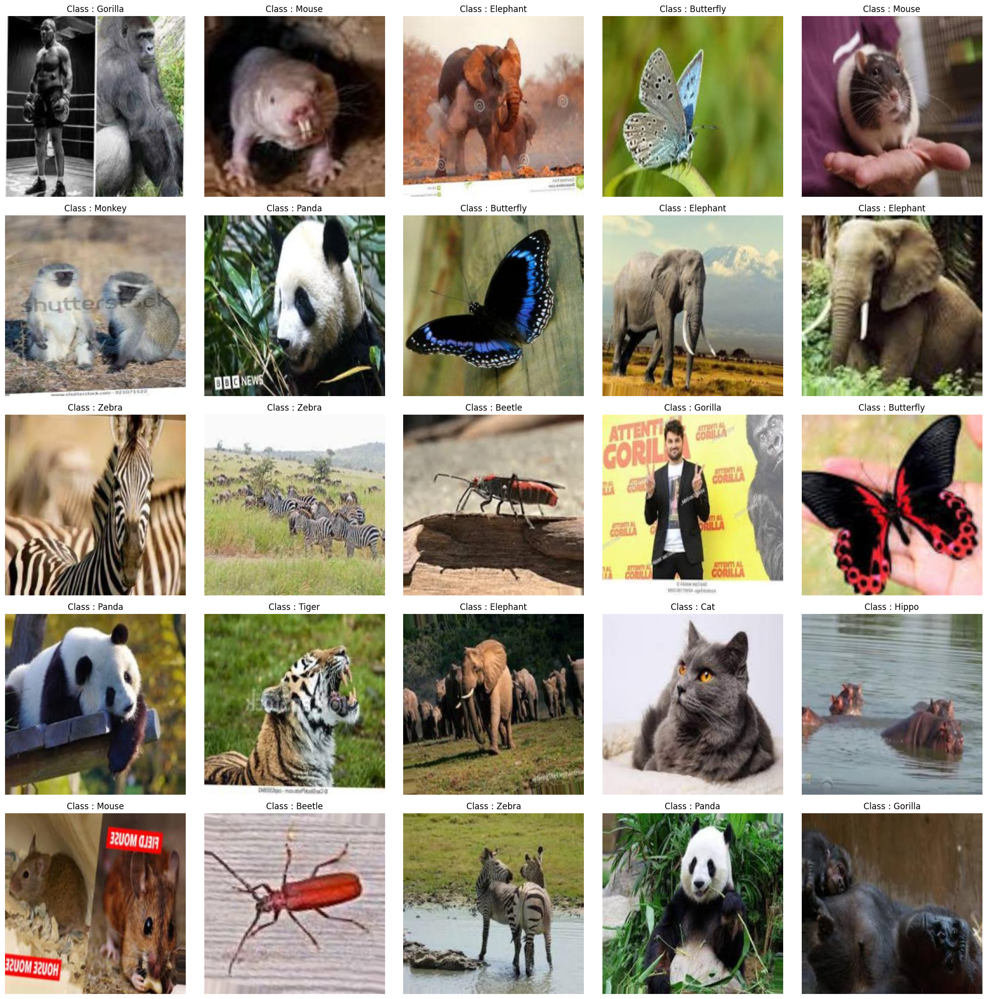

In [14]:
show_images(data=train_ds)

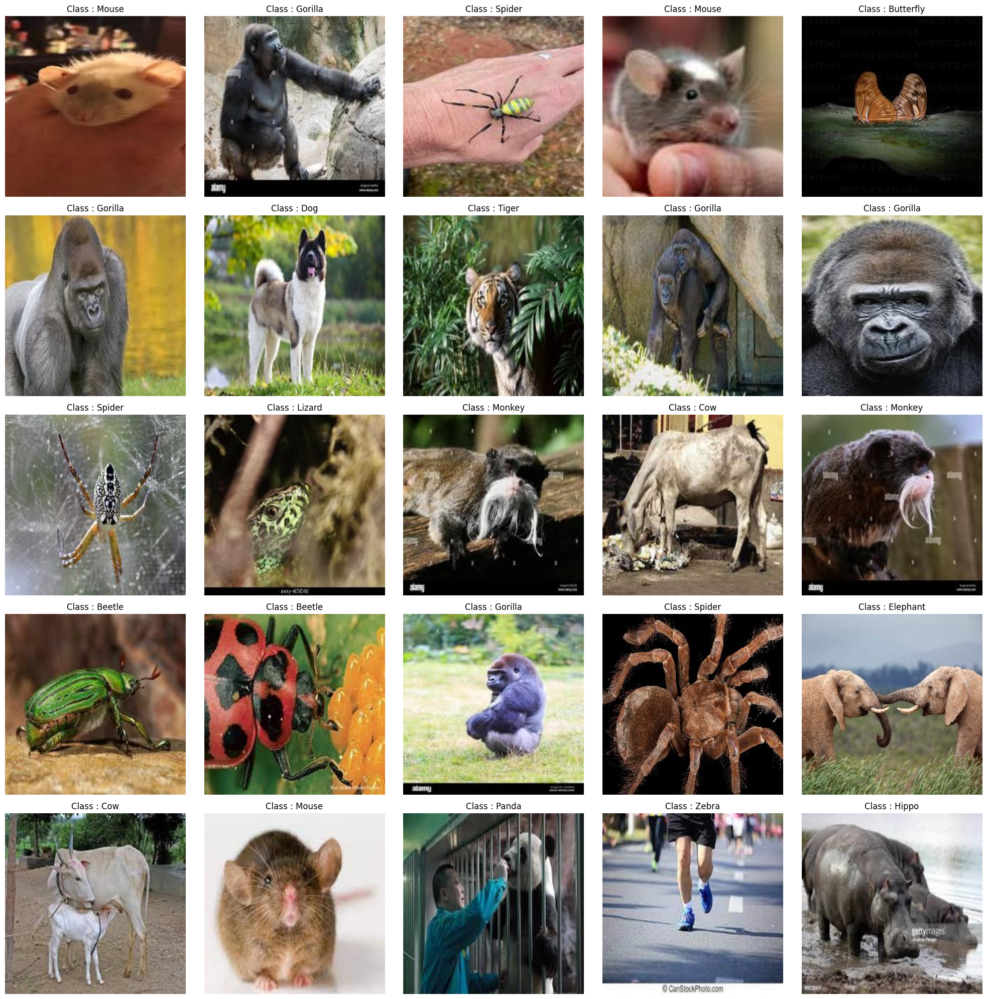

In [15]:
show_images(data=valid_ds)

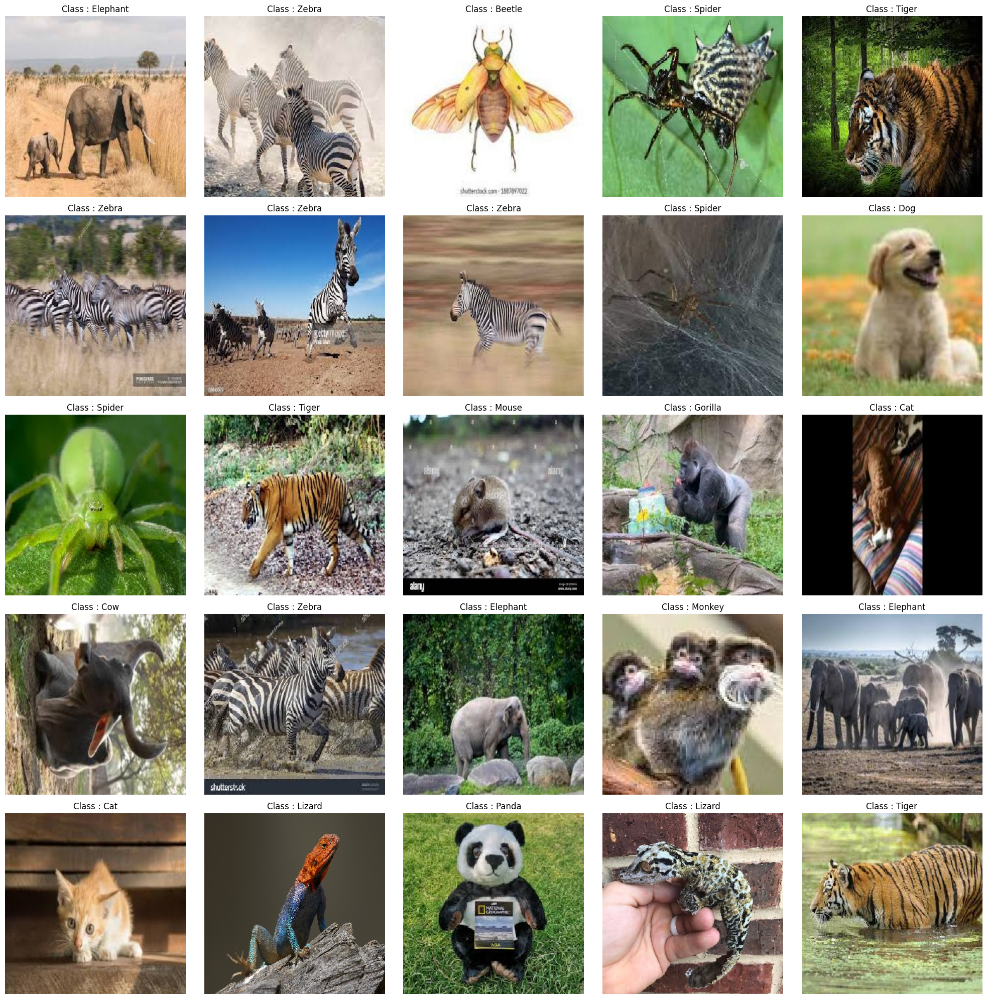

In [16]:
show_images(data=test_ds)

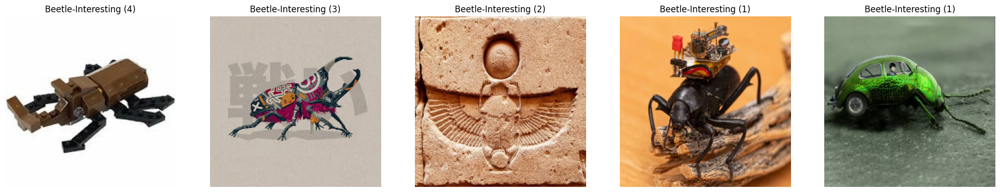

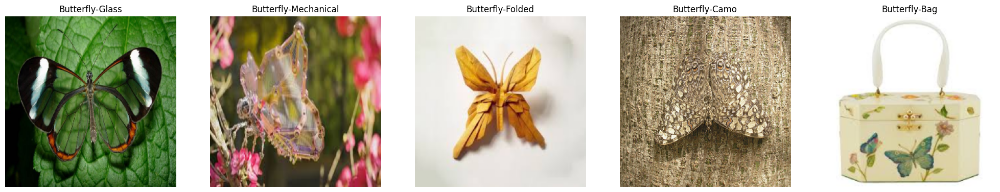

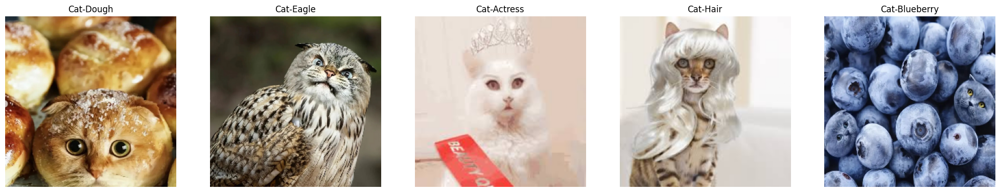

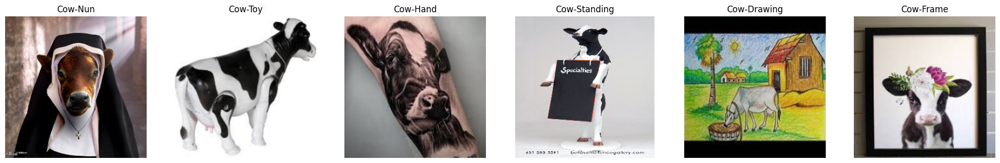

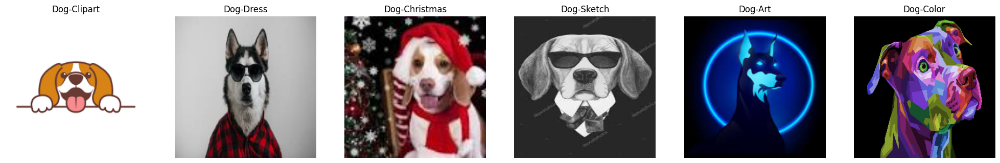

...

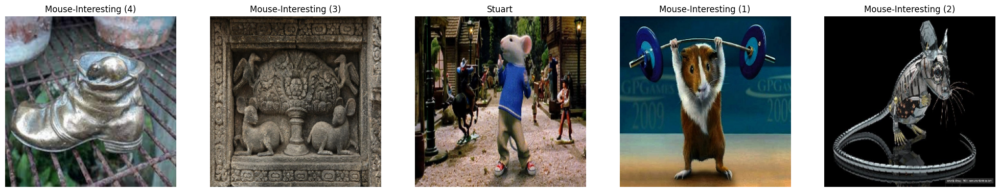

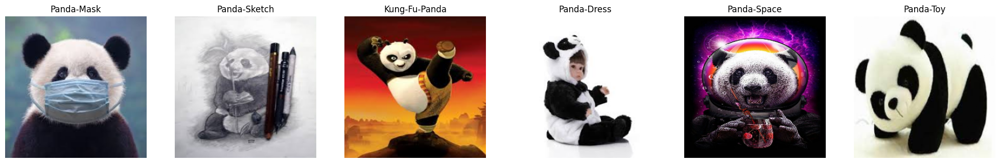

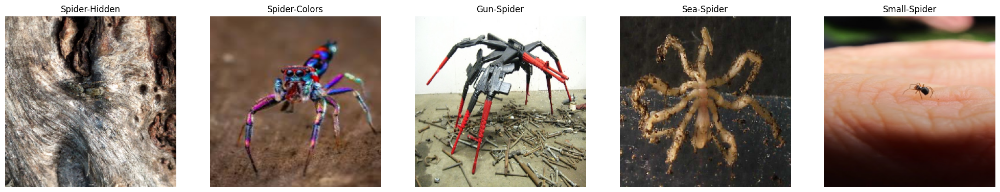

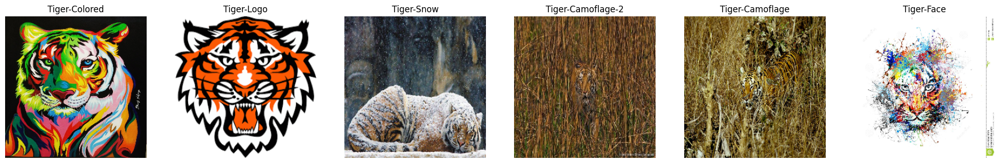

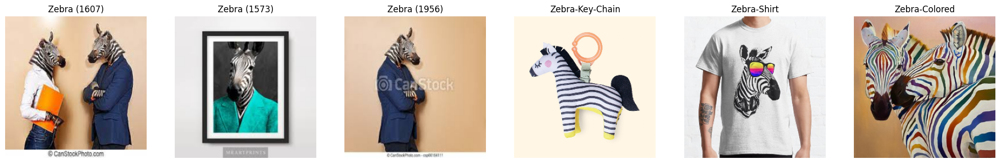

In [17]:
path = '/content/Animal Classification/Interesting Data/Interesting Data/'
interesting_images = [glob(path + name + "/*") for name in class_names]

# Interesting Cat Images

for name in class_names:
    plt.figure(figsize=(25, 8))
    cat_interesting = interesting_images[class_names.index(name)]
    for i, i_path in enumerate(cat_interesting):
        name = i_path.split("/")[-1].split(".")[0]
        image = load_image(i_path)
        plt.subplot(1,len(cat_interesting),i+1)
        show_image(image, title=name.title())
    plt.show()

#Big Transfer - BiT


In [18]:
bit_model_url = "https://tfhub.dev/google/bit/m-r50x1/1"
bit_module = hub.KerasLayer(bit_model_url)

# Create BiT


In [19]:
model = Sequential([
    bit_module,
    Dense(n_classes, activation='softmax', kernel_initializer='zeros')
], name='bit-custom')

# Define Optimizer

In [20]:
BATCH_SIZE = 32
lr = 1e-3 * BATCH_SIZE/512
print(f"Learning rate : {lr}")

Learning rate : 6.25e-05


In [21]:
SCHEDULE_BOUNDARIES = [
    200,
    300,
    400,
]  # more the dataset size the schedule length increase

In [22]:
lr_schedule = tf.keras.optimizers.schedules.PiecewiseConstantDecay(
    boundaries=SCHEDULE_BOUNDARIES,
    values=[
        lr,
        lr * 0.1,
        lr * 0.01,
        lr * 0.001,
    ],
)
optimizer = tf.keras.optimizers.SGD(learning_rate=lr_schedule, momentum=0.9)

# Compile Model

In [23]:
model.compile(
    loss='sparse_categorical_crossentropy',
    optimizer=optimizer,
    metrics=['accuracy']
)

# Callbacks

In [24]:
cbs = [EarlyStopping(patience=5, restore_best_weights=True), ModelCheckpoint('bit-custom.h5', save_best_only=True)]

# Model Training

In [1]:
history = model.fit(train_ds, validation_data=valid_ds, epochs=1, callbacks=cbs)


NameError: name 'model' is not defined

# Learning Curve

In [ ]:
# pd.DataFrame(history.history).plot(figsize=(8,5))
# plt.grid()
# plt.show()

# Evaluation

In [ ]:
model = load_model('../input/big-transfer-animal-classification/bit-custom.h5', custom_objects={'KerasLayer':bit_module})

In [ ]:
model.evaluate(test_ds)

In [ ]:
# Visualize Predictions
show_images(model=model, data=test_ds)


In [ ]:
path = '../input/animal-image-classification-dataset/Animal Classification/Interesting Images/'
interesting_images = [glob(path + name + "/*") for name in class_names]

# Interesting Cat Images

for name in class_names:
    plt.figure(figsize=(25, 8))
    cat_interesting = interesting_images[class_names.index(name)]
    for i, i_path in enumerate(cat_interesting):
        name = i_path.split("/")[-1].split(".")[0]
        image = load_image(i_path)
        plt.subplot(1,len(cat_interesting),i+1)

        # Model Prediction
        org_class = name.title()
        preds = model.predict(image[np.newaxis,...])[0]
        pred_class = class_names[np.argmax(preds)]
        confidence_score = np.round(preds[np.argmax(preds)],2)


        # Configure Title
        title = f"Pred : {pred_class}\nConfidence : {confidence_score:.2}"

        show_image(image, title=title)
    plt.show()